This notebook demonstrates various techniques for generating local explanations of facial expression recognition models, specifically focusing on tree-based models trained on Facial Action Units (AUs) extracted from the AffectNet dataset.

1. Data Loading: Loads pre-processed AffectNet data including Action Units and corresponding images.
2. Model Training: Trains an XGBoost Classifier on numerical Action Units for 8 emotion classes.
3. Inherently Interpretable Models: Utilizes an Explainable Boosting Machine (EBM) to generate inherently interpretable local explanations.
4. Individual Conditional Expectation (ICE) Plots: Explores how individual instance predictions change with feature variations.
5. LIME (Local Interpretable Model-agnostic Explanations): Generates local, model-agnostic explanations by perturbing data instances and training simple surrogate models.
6. SHAP (SHapley Additive exPlanations): Provides both local and global explanations by assigning contribution values to each feature based on game theory.

This notebook is designed to guide users through the process of understanding why a model makes a specific prediction for a single instance, leveraging common XAI tools like LIME and SHAP.


In [ ]:
colab = True # set to False if running locally or True if using Colab

In [ ]:
  # fix xgboost incompatiblity issue
  %pip uninstall -y -q scikit-learn
  %pip install -q scikit-learn==1.5.2
  %pip install -q interpret
  %pip install -q lime
  %pip install -q shap

Running on Google Colab and installing dependencies
Cloning into 'xai_ac_sose25'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (40/40), done.
remote: Total 52 (delta 20), reused 29 (delta 7), pack-reused 0 (from 0)
Receiving objects: 100% (52/52), 1.52 MiB | 4.12 MiB/s, done.
Resolving deltas: 100% (20/20), done.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 142.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 60.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.6/16.6 MB 131.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.7/6.7 MB 139.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 153.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 95.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━

In [ ]:
import sys
import os

if colab:
  sys.path.append(os.path.realpath('xai_ac'))
else:
  sys.path.append(os.path.realpath('../'))

In [ ]:
from pathlib import Path

import pandas as pd
import numpy as np

from sklearn.metrics import classification_report

import seaborn as sns
import matplotlib.pyplot as plt

from skimage import io

import utils
import img_utils

In [ ]:
base_dir = Path('../data/') if not colab else Path('wise24_xai_ac/data/')

In [ ]:
# download the AffectNet dataset extracted features and a sample set of images for visualization
affnet_dir = utils.download_file('https://uni-bielefeld.sciebo.de/s/EmfF9r93LG4jcT9/download',
                          file_name='affectnet_data.zip',
                          cache_dir=base_dir,
                          extract=True,
                          force_download=False,     # set to False if you have already downloaded the dataset
                          archive_folder='affectnet_data')
affnet_dir

File downloaded to: wise24_xai_ac/data/affectnet_data.zip


PosixPath('wise24_xai_ac/data/affectnet_data')

## Data Loading

### Loading Images and Action Units

In the next cell, you will load csv files that contain extracted actions units and paths to the corresponding images.  

In [ ]:

# Full data from training and evaluation
train_csv = affnet_dir / 'affectnet_aus/train_aus.csv'
val_csv = affnet_dir / 'affectnet_aus/val_aus.csv'

# load training and validation data as pandas dataframes
# action units extracted from the AffectNet dataset via OpenFace
df_train = pd.read_csv(train_csv)
df_val = pd.read_csv(val_csv)

# smaller dataset for explanations
xai_csv = affnet_dir / 'affectnet_aus/eval_aus.csv'
df_xai = pd.read_csv(xai_csv)
df_xai['image'] = df_xai['image'].str.replace('../data', str(affnet_dir))

# get the class labels
class_names = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']  # same class labels as before

# Gets all images from folder used for XAI tasks
images = [io.imread(f) for f in df_xai.image]

Here is a feature name map to make AUs values easier to Read in Shap Plots

In [ ]:
# Mapping of Action Units (AUs) to their names
AU_MAP = {
    "AU01": "Inner Brow Raiser",
    "AU02": "Outer Brow Raiser",
    "AU04": "Brow Lowerer",
    "AU05": "Upper Lid Raiser",
    "AU06": "Cheek Raiser",
    "AU07": "Lid Tightener",
    "AU09": "Nose Wrinkler",
    "AU10": "Upper Lip Raiser",
    "AU12": "Lip Corner Puller",
    "AU14": "Dimpler",
    "AU15": "Lip Corner Depressor",
    "AU17": "Chin Raiser",
    "AU20": "Lip Stretcher",
    "AU23": "Lip Tightener",
    "AU25": "Lips Part",
    "AU26": "Jaw Drop",
    "AU28": "Lip Suck",
    "AU45": "Blink",
}

# Generate mappings for both 'r' (regression) and 'c' (classification) versions
AU_FEATURE_MAP = {f"{au}_r": f"{au} - {name} - R" for au, name in AU_MAP.items()}
AU_FEATURE_MAP.update({f"{au}_c": f"{au} - {name} - C" for au, name in AU_MAP.items()})

# Print the mapping
print(AU_FEATURE_MAP)

{'AU01_r': 'AU01 - Inner Brow Raiser - R', 'AU02_r': 'AU02 - Outer Brow Raiser - R', 'AU04_r': 'AU04 - Brow Lowerer - R', 'AU05_r': 'AU05 - Upper Lid Raiser - R', 'AU06_r': 'AU06 - Cheek Raiser - R', 'AU07_r': 'AU07 - Lid Tightener - R', 'AU09_r': 'AU09 - Nose Wrinkler - R', 'AU10_r': 'AU10 - Upper Lip Raiser - R', 'AU12_r': 'AU12 - Lip Corner Puller - R', 'AU14_r': 'AU14 - Dimpler - R', 'AU15_r': 'AU15 - Lip Corner Depressor - R', 'AU17_r': 'AU17 - Chin Raiser - R', 'AU20_r': 'AU20 - Lip Stretcher - R', 'AU23_r': 'AU23 - Lip Tightener - R', 'AU25_r': 'AU25 - Lips Part - R', 'AU26_r': 'AU26 - Jaw Drop - R', 'AU28_r': 'AU28 - Lip Suck - R', 'AU45_r': 'AU45 - Blink - R', 'AU01_c': 'AU01 - Inner Brow Raiser - C', 'AU02_c': 'AU02 - Outer Brow Raiser - C', 'AU04_c': 'AU04 - Brow Lowerer - C', 'AU05_c': 'AU05 - Upper Lid Raiser - C', 'AU06_c': 'AU06 - Cheek Raiser - C', 'AU07_c': 'AU07 - Lid Tightener - C', 'AU09_c': 'AU09 - Nose Wrinkler - C', 'AU10_c': 'AU10 - Upper Lip Raiser - C', 'AU12_

In [ ]:
# update the feature names in the dataframe to be more descriptive
df_train.rename(columns=AU_FEATURE_MAP, inplace=True)
df_val.rename(columns=AU_FEATURE_MAP, inplace=True)
df_xai.rename(columns=AU_FEATURE_MAP, inplace=True)

In [ ]:
# get only the columns storing action units from the dataframe
# there are also facial landmarks and other features in the dataset could be useful
# but we igore them for now and focus on action units
feature_names = [col for col in df_val.columns if col.startswith('AU')]
numerical_features = [feat for feat in feature_names if '- R' in feat]
numerical_idxs = [i for i, feat in enumerate(feature_names) if '- R' in feat]
categorical_features = [feat for feat in feature_names if '- C' in feat]
categorical_idxs = [i for i, feat in enumerate(feature_names) if '- C' in feat]

## Model Training and Evaluation

First, let's load the data and the trained models. Then we will evaluate the model peformance, before we start with the explanations.

In [ ]:
from xgboost import XGBClassifier

### Setup the Datasets

In [ ]:
# we will only use numerical features to remove collinearity with categorical features
X_train = df_train[numerical_features]
y_train = df_train['class']
X_test = df_val[numerical_features]
y_test = df_val['class']

X_xai = df_xai[numerical_features]
y_xai = df_xai['class']

print('Training data shape:', X_train.shape, y_train.shape)
print('Test data shape:', X_test.shape, y_test.shape)
print('XAI data shape:', X_xai.shape, y_xai.shape)

Training data shape: (36685, 17) (36685,)
Test data shape: (3908, 17) (3908,)
XAI data shape: (80, 17) (80,)


### Train the Model

Now let's train the XGBoost Model on the split dataset.

In [ ]:
# # Train model from scratch
random_state = 10
clf = XGBClassifier(max_depth=20, eta=0.1, reg_lambda=3, random_state=random_state)
clf.fit(X_train, y_train)
clf.score(X_train, y_train)

0.9962382445141066

### Evaluate the Model

Now we will evaluate it on the test dataset. Unfortunately, the accuracy is only $40\%$ but this is still well above chance guessing which would be $1 / 8 * 100 = 12.5\%$ accuracy (since there are 8 total classes)

In [ ]:
# get model predictions
y_test_preds = clf.predict(X_test)
y_test_true = y_test

# eval results
print(classification_report(y_test_true, y_test_preds, target_names=class_names))

              precision    recall  f1-score   support

     Neutral       0.30      0.41      0.35       485
       Happy       0.55      0.65      0.59       488
         Sad       0.37      0.37      0.37       490
    Surprise       0.37      0.34      0.35       488
        Fear       0.43      0.43      0.43       487
     Disgust       0.49      0.34      0.40       493
       Anger       0.36      0.39      0.37       482
    Contempt       0.38      0.25      0.30       495

    accuracy                           0.40      3908
   macro avg       0.40      0.40      0.40      3908
weighted avg       0.40      0.40      0.40      3908



### Setup XAI dataset and Predictions

Evaluate the model and get predictions for the XAI subset

In [ ]:
# Evaluate model on XAI data
y_xai_preds = clf.predict(X_xai)
y_xai_true = y_xai

df_xai['xgb_pred'] = y_xai_preds

print(classification_report(y_xai_true, y_xai_preds, target_names=class_names))

              precision    recall  f1-score   support

     Neutral       0.24      0.40      0.30        10
       Happy       0.64      0.70      0.67        10
         Sad       0.50      0.60      0.55        10
    Surprise       0.38      0.30      0.33        10
        Fear       0.62      0.50      0.56        10
     Disgust       0.50      0.40      0.44        10
       Anger       0.18      0.20      0.19        10
    Contempt       0.60      0.30      0.40        10

    accuracy                           0.42        80
   macro avg       0.46      0.42      0.43        80
weighted avg       0.46      0.42      0.43        80



**Preview the Dataset with Predictions**

The code below will display images from the XAI dataset.
- Try changing value of `start` to get a new set of images (there are 10 images for each class; for example, the class happy will be at indexes 10-19)
- Search through the images to find some that might be interesting to Explain

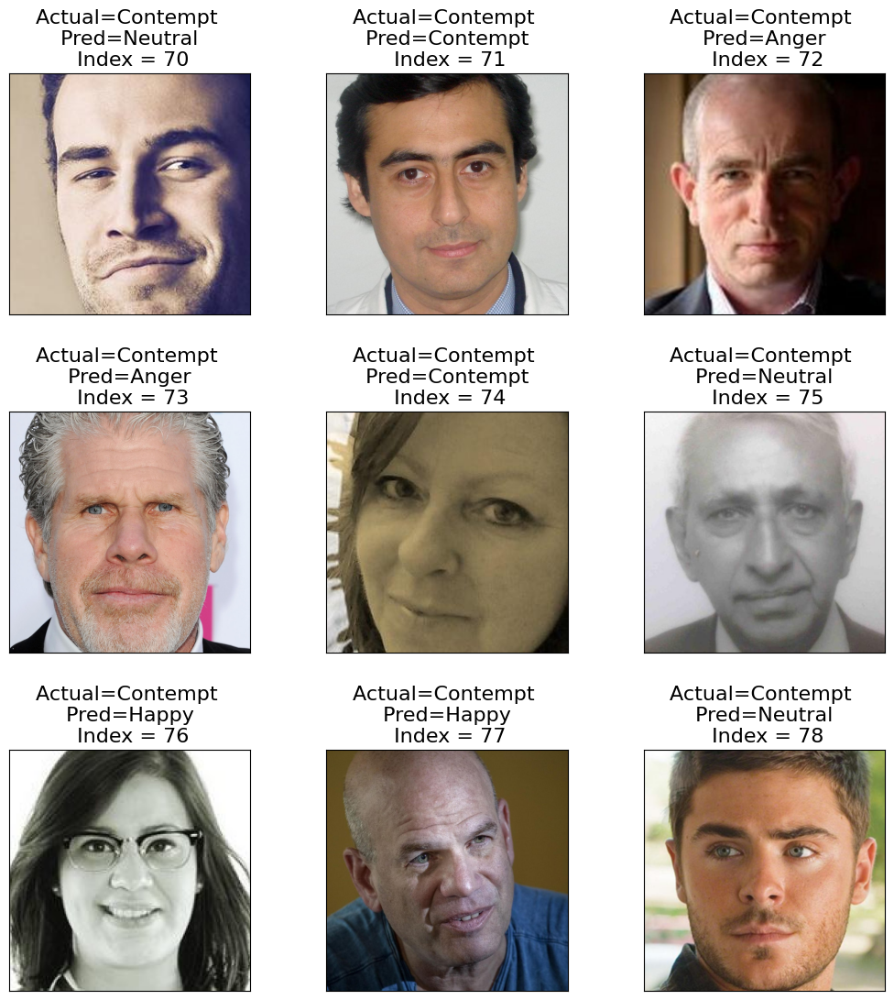

In [ ]:
start=70
img_utils.display_nine_images(images, df_xai['class'], df_xai['xgb_pred'], start)

## Main Tasks A: Generate Local Explanations

Following the methods we used in the last exercise, we will now generate local explanation for individual predications


### Generate Explanations from an Interpretable Model


In [ ]:
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show

In [ ]:
ebm = ExplainableBoostingClassifier(reg_lambda=3)
ebm.fit(X_train, y_train)
ebm.score(X_train, y_train)

/usr/local/lib/python3.11/dist-packages/interpret/glassbox/_ebm/_ebm.py:1173: UserWarning: Detected multiclass problem. Forcing interactions to 0. Multiclass interactions only have local explanations. They are not currently displayed in the global explanation visualizations. Set interactions=0 to disable this warning. If you still want multiclass interactions, this API accepts a list, and the measure_interactions function can be used to detect them.
  warn(


0.39915496797056016

In [ ]:
# get model predictions
y_test_preds = ebm.predict(X_test)
y_test_true = y_test

# eval results
print(classification_report(y_test_true, y_test_preds, target_names=class_names))

              precision    recall  f1-score   support

     Neutral       0.29      0.39      0.33       485
       Happy       0.56      0.68      0.61       488
         Sad       0.33      0.31      0.32       490
    Surprise       0.36      0.34      0.35       488
        Fear       0.40      0.37      0.38       487
     Disgust       0.40      0.27      0.32       493
       Anger       0.31      0.36      0.33       482
    Contempt       0.36      0.29      0.32       495

    accuracy                           0.38      3908
   macro avg       0.38      0.38      0.37      3908
weighted avg       0.38      0.38      0.37      3908



Correct indices: [71, 74, 24]
Incorrect indices: [28, 25, 73]
Indices for explanation: [71, 74, 24, 28, 25, 73]

Explanation for index 71:


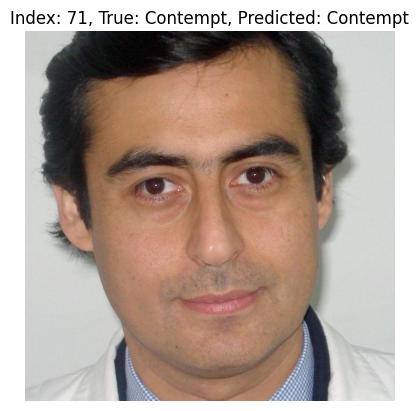


Explanation for index 74:


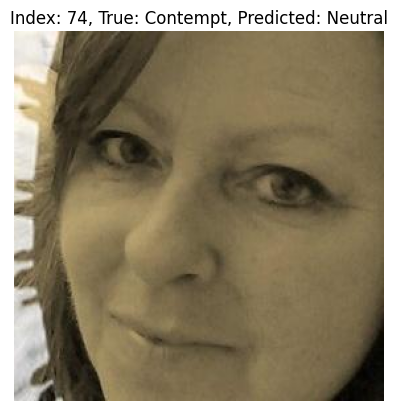


Explanation for index 24:


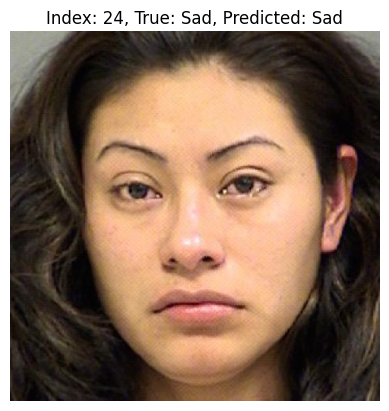


Explanation for index 28:


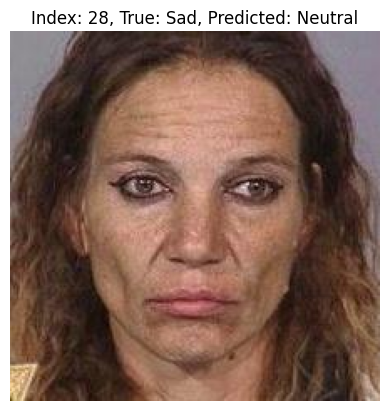


Explanation for index 25:


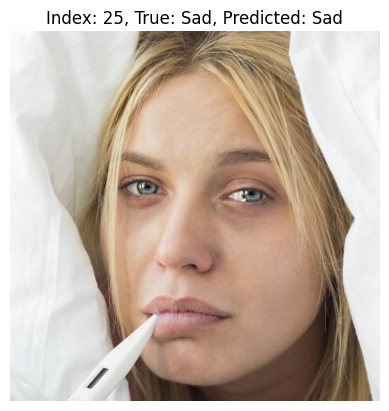


Explanation for index 73:


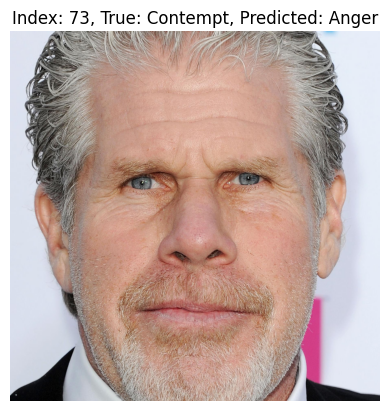

In [ ]:

correct_indices = [71, 74, 24]
incorrect_indices = [28, 25, 73]

print("Correct indices:", correct_indices)
print("Incorrect indices:", incorrect_indices)

explanation_indices = correct_indices[:3] + incorrect_indices[:3]
print("Indices for explanation:", explanation_indices)

for idx in explanation_indices:
    print(f"\nExplanation for index {idx}:")
    local_explanation = ebm.explain_local(X_xai.iloc[[idx]], y_xai.iloc[[idx]])


    show(local_explanation)

    img = images[idx]
    true_label = class_names[y_xai.iloc[idx]]
    predicted_label = class_names[ebm.predict(X_xai.iloc[[idx]])[0]]

    plt.imshow(img)
    plt.title(f"Index: {idx}, True: {true_label}, Predicted: {predicted_label}")
    plt.axis('off')
    plt.show()

### Generate individual conditional expectation (ICE) plots

Individual conditional expectation (ICE) plots are similar to PDP, but show how an individual instance's prediction changes when a feature changes. See https://christophm.github.io/interpretable-ml-book/ice.html for a more indepth description.


In [ ]:
from sklearn.inspection import PartialDependenceDisplay

Indices for explanation: [71, 74, 24, 28, 25, 73]

Generating ICE plots for class: Neutral


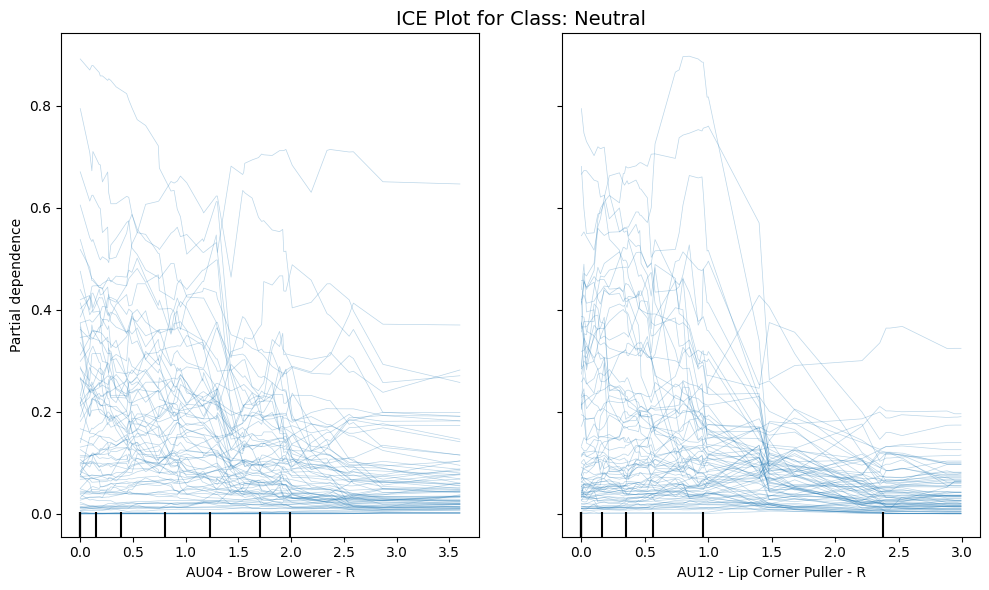


Generating ICE plots for class: Happy


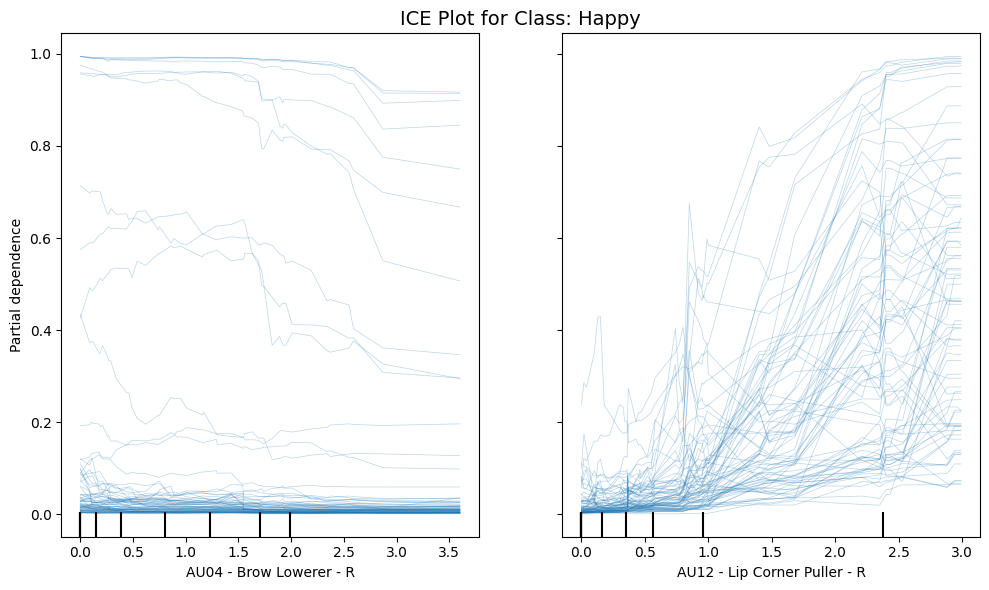


Generating ICE plots for class: Sad


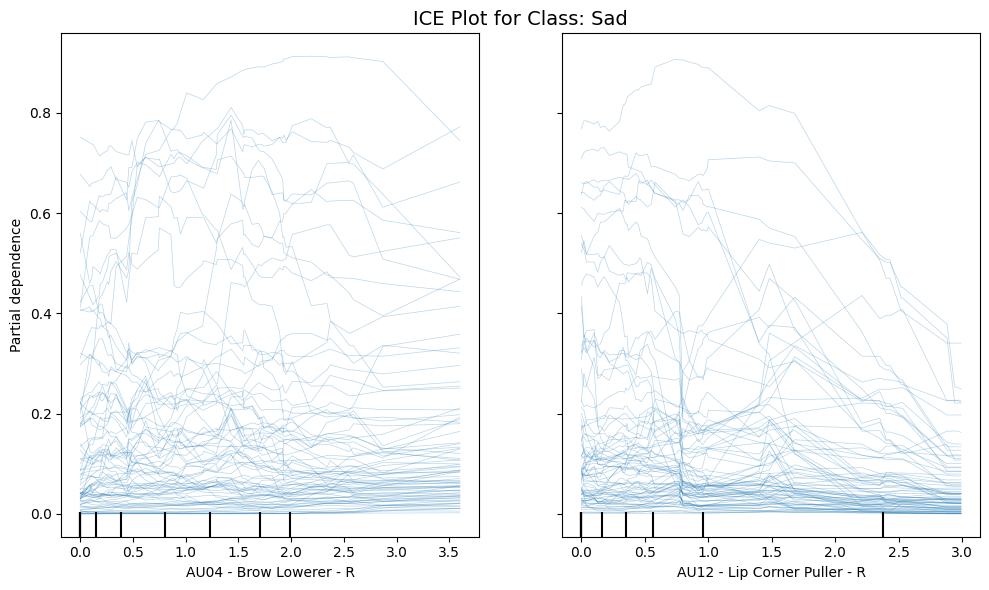


Generating ICE plots for class: Surprise


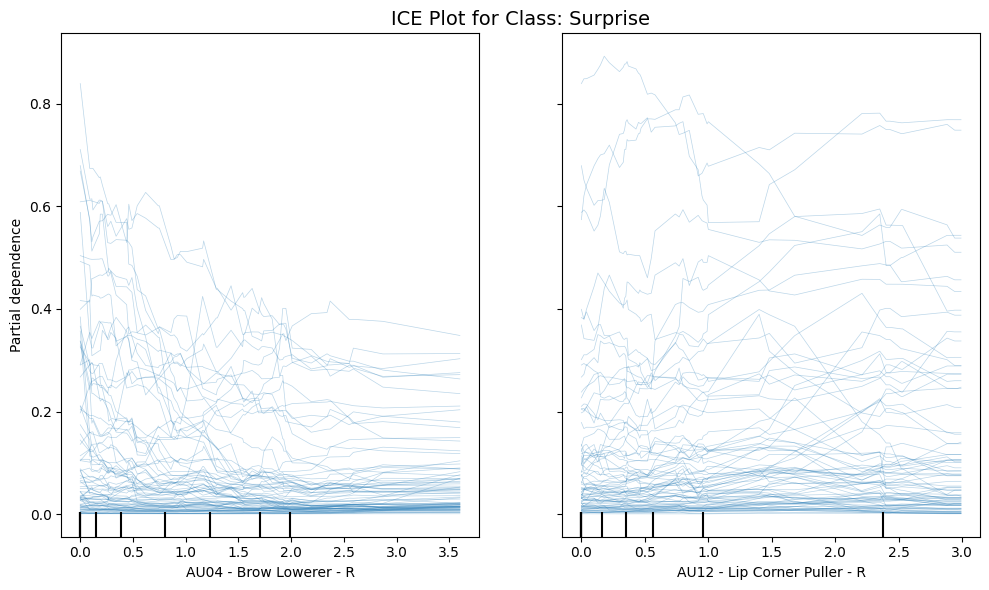


Generating ICE plots for class: Fear


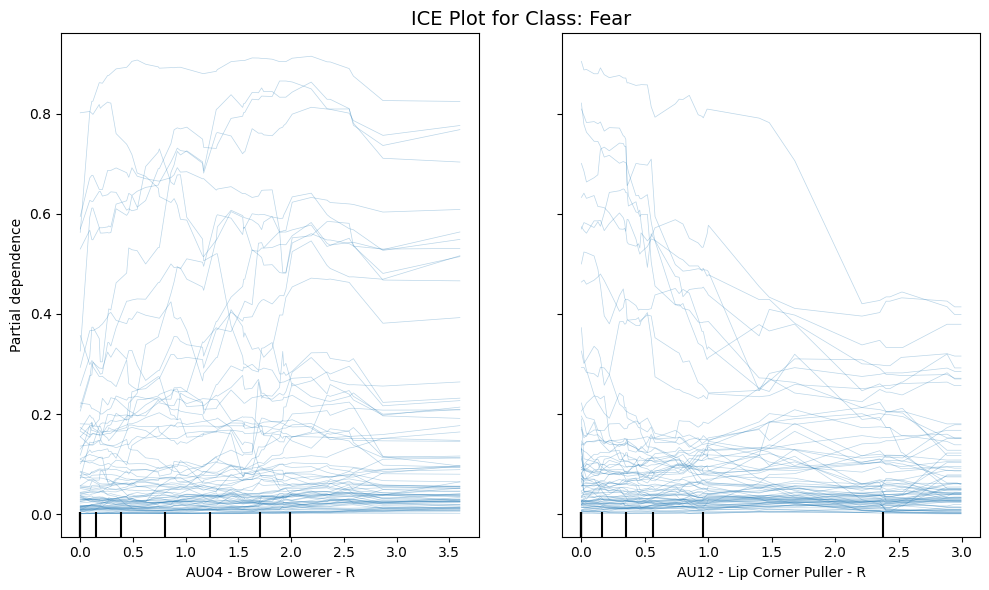


Generating ICE plots for class: Disgust


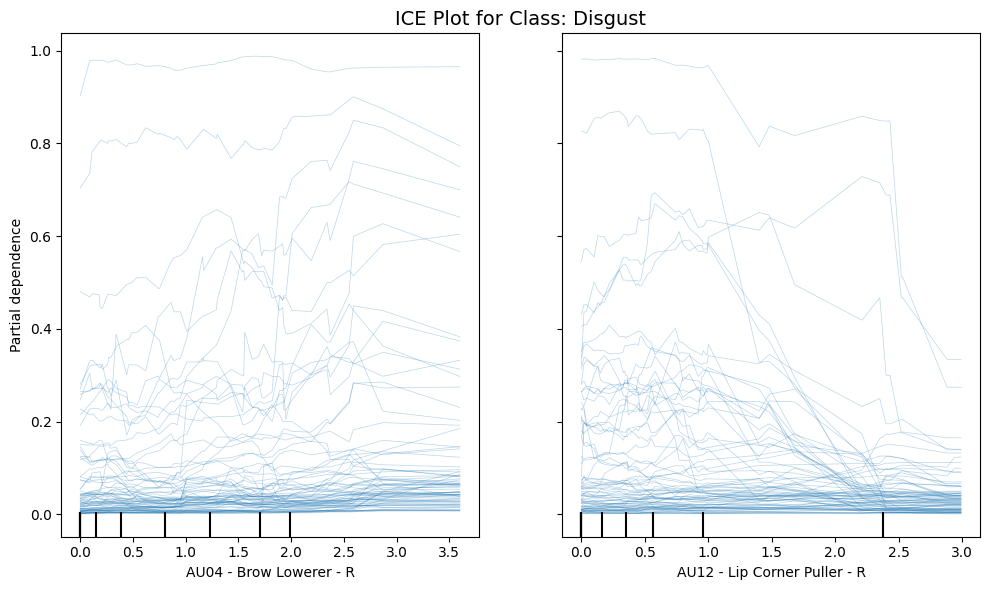


Generating ICE plots for class: Anger


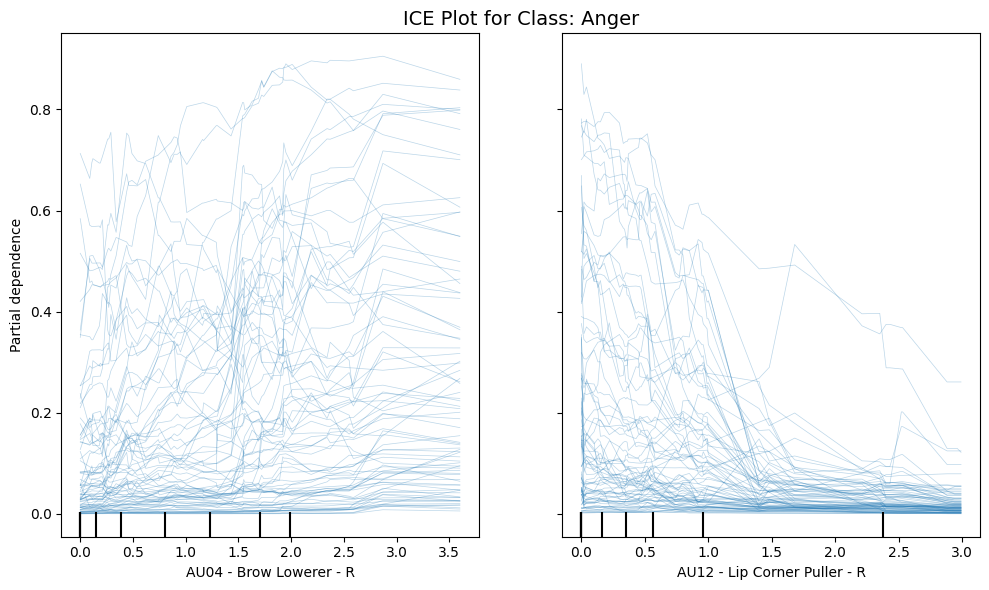


Generating ICE plots for class: Contempt


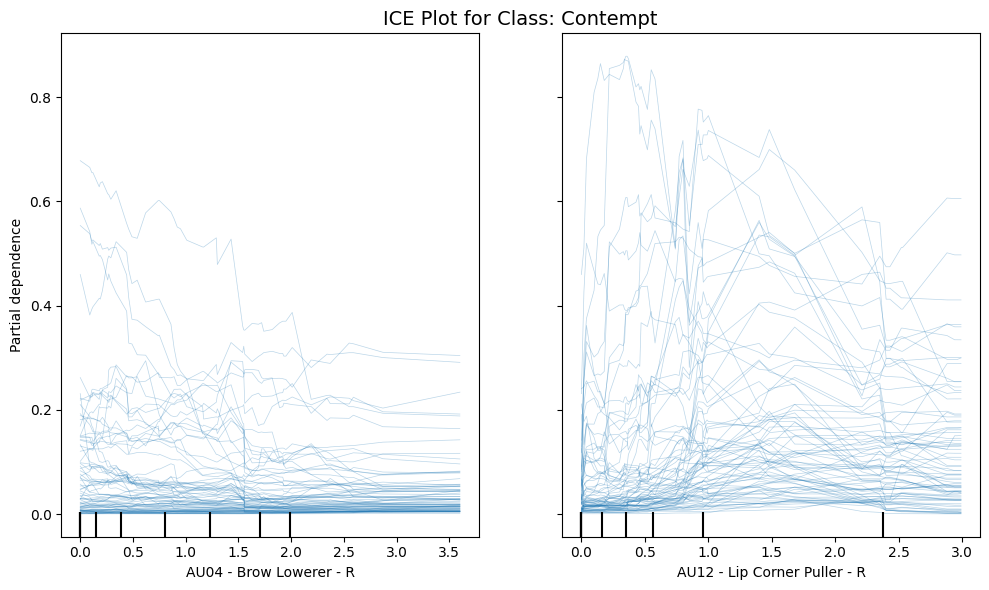

In [ ]:
explanation_indices = correct_indices[:3] + incorrect_indices[:3]
print("Indices for explanation:", explanation_indices)

# Features and class names
features_to_plot = ['AU04 - Brow Lowerer - R', 'AU12 - Lip Corner Puller - R']
class_names = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']

# Generate ICE plots
for class_idx, emotion_name in enumerate(class_names):
    print(f"\nGenerating ICE plots for class: {emotion_name}")

    fig, ax = plt.subplots(figsize=(10, 6))  # Set figure size
    display = PartialDependenceDisplay.from_estimator(
        clf,
        X_xai,
        features_to_plot,
        kind='individual',
        feature_names=numerical_features,
        target=class_idx,
        response_method='predict_proba',
        n_jobs=2,
        percentiles=(0, 1),
        ax=ax
    )

    ax.set_title(f"ICE Plot for Class: {emotion_name}", fontsize=14)
    ax.set_ylabel("Predicted Probability")
    ax.set_xlabel("Feature Value")
    plt.tight_layout()
    plt.show()

## Generate Explanations with LIME

Local Interpretable Model-agnostic Explanations (LIME) is a widely used method for generating local explanations by learning an interpretable model in the vicinity of a specific instance. It does so by perturbing the instance to create a neighborhood of similar samples, which are then used to train the local surrogate model. You can read more about it in the original paper: [“Why Should I Trust You?” Explaining the Predictions of Any Classifier](https://dl.acm.org/doi/10.1145/2939672.2939778) by Ribeiro et al. (2016).

In [ ]:
import lime
from lime.lime_tabular import LimeTabularExplainer

### Generate Local LIME Explanations

In this part you will use the [LIME Python package](https://github.com/marcotcr/lime) to generate explanations on the AffectNet dataset.  




Explanation for index 71:


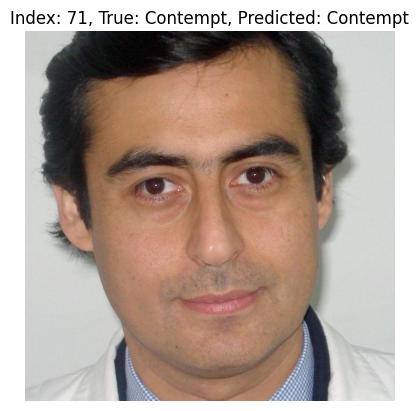


Explanation for index 74:


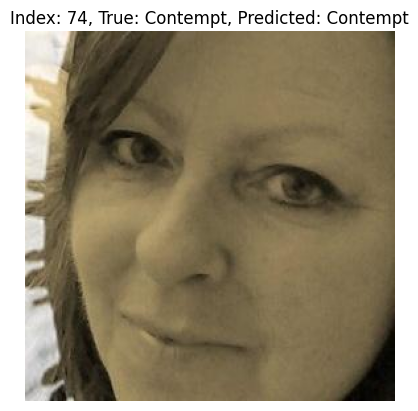


Explanation for index 24:


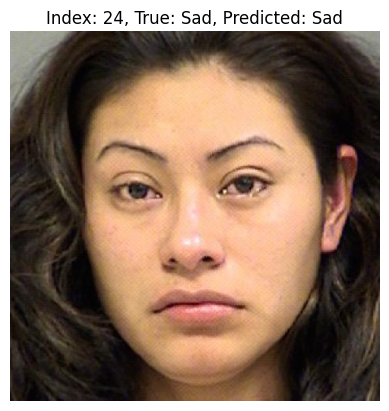


Explanation for index 28:


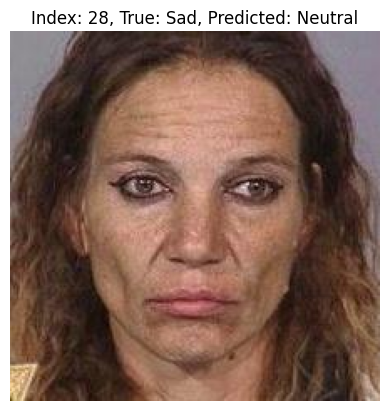


Explanation for index 25:


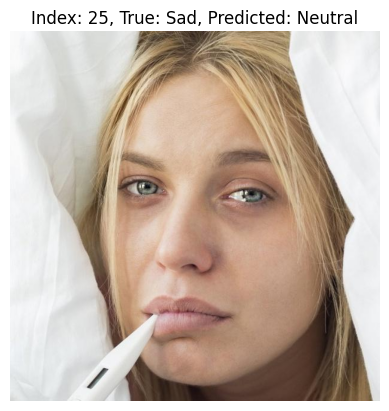


Explanation for index 73:


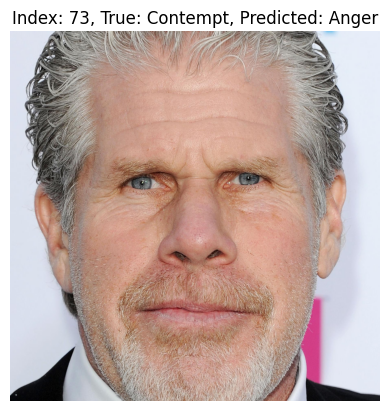

In [ ]:
import matplotlib.pyplot as plt
explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=numerical_features,
    class_names=class_names,
    mode='classification'
)

for idx in explanation_indices:
    print(f"\nExplanation for index {idx}:")
    true_label = class_names[y_xai.iloc[idx]]
    predicted_label_idx = clf.predict(X_xai.iloc[[idx]])[0]
    predicted_label = class_names[predicted_label_idx]

    plt.imshow(images[idx])
    plt.title(f"Index: {idx}, True: {true_label}, Predicted: {predicted_label}")
    plt.axis('off')
    plt.show()

    exp = explainer.explain_instance(
        data_row=X_xai.iloc[idx].values,
        predict_fn=clf.predict_proba,
        num_features=5,  # Number of features to show in explanation
        top_labels=3     # Show explanation for the top 3 predicted labels
    )
    exp.show_in_notebook(show_table=True, show_all=False)

#### Task Questions

1. Explain in more detail how LIME generates the local neighborhood and how this is used to create a local model used for explanations.  



2. What do the generated explanations reveal about the models predictions? Do they align with the expected action units for the given emotion (see "Emotions and Action Units": https://imotions.com/blog/learning/research-fundamentals/facial-action-coding-system/)?



3. In your opinion, how understandable are the explanations? Why?


## Generate Explanations with SHAP

SHAP (SHapley Additive exPlanations) is a popular method for generating local explanations by assigning each feature a contribution value based on Shapley values from game theory. It explains a model’s prediction by considering all possible combinations of feature contributions. We've already read about the SHAP Tree Explainer; you can also read more about SHAP in the original paper that provides a more generalized description of the method: [“A Unified Approach to Interpreting Model Predictions”](https://arxiv.org/abs/1705.07874) by Lundberg and Lee (2017).


In [ ]:
import shap

###  Generate Local SHAP Explanations




Explaining Index: 71
True Label: Contempt, Predicted Label: Contempt


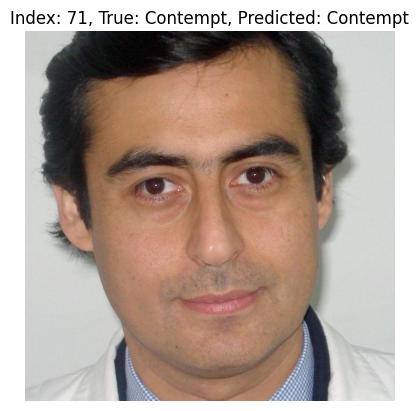

SHAP Explanation for Predicted Class: Contempt
Error generating waterfall plot for predicted class Contempt: index 71 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 71


Error generating force plot: index 71 is out of bounds for axis 0 with size 17

Explaining Index: 74
True Label: Contempt, Predicted Label: Contempt


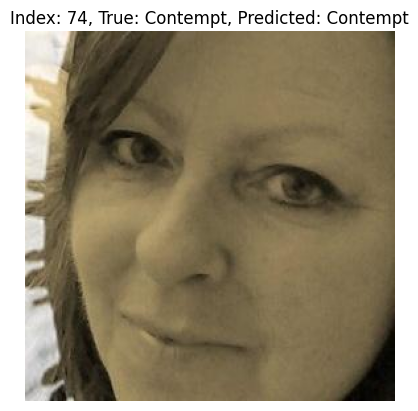

SHAP Explanation for Predicted Class: Contempt
Error generating waterfall plot for predicted class Contempt: index 74 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 74


Error generating force plot: index 74 is out of bounds for axis 0 with size 17

Explaining Index: 24
True Label: Sad, Predicted Label: Sad


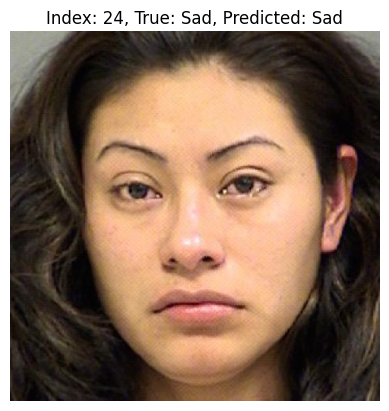

SHAP Explanation for Predicted Class: Sad
Error generating waterfall plot for predicted class Sad: index 24 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 24


Error generating force plot: index 24 is out of bounds for axis 0 with size 17

Explaining Index: 28
True Label: Sad, Predicted Label: Neutral


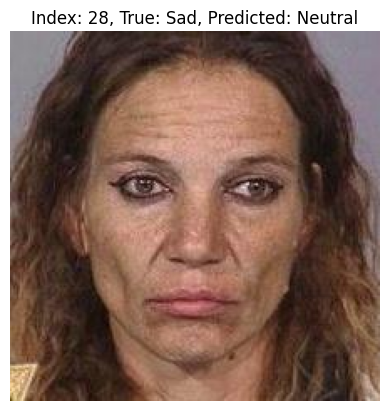

SHAP Explanation for Predicted Class: Neutral
Error generating waterfall plot for predicted class Neutral: index 28 is out of bounds for axis 0 with size 17
SHAP Explanation for True Class: Sad
Error generating waterfall plot for true class Sad: index 28 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 28


Error generating force plot: index 28 is out of bounds for axis 0 with size 17

Explaining Index: 25
True Label: Sad, Predicted Label: Neutral


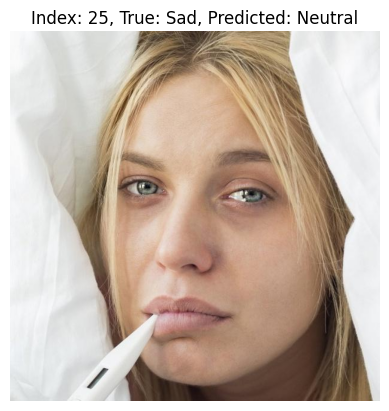

SHAP Explanation for Predicted Class: Neutral
Error generating waterfall plot for predicted class Neutral: index 25 is out of bounds for axis 0 with size 17
SHAP Explanation for True Class: Sad
Error generating waterfall plot for true class Sad: index 25 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 25


Error generating force plot: index 25 is out of bounds for axis 0 with size 17

Explaining Index: 73
True Label: Contempt, Predicted Label: Anger


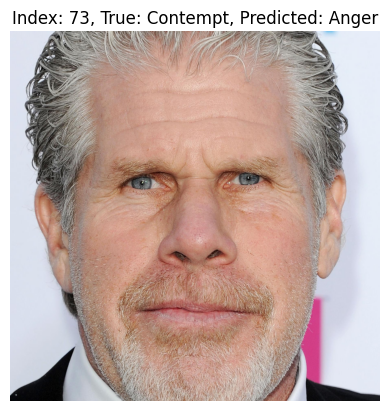

SHAP Explanation for Predicted Class: Anger
Error generating waterfall plot for predicted class Anger: index 73 is out of bounds for axis 0 with size 17
SHAP Explanation for True Class: Contempt
Error generating waterfall plot for true class Contempt: index 73 is out of bounds for axis 0 with size 17
SHAP Force Plot for Index: 73


Error generating force plot: index 73 is out of bounds for axis 0 with size 17


In [ ]:
explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(X_xai)

# Map class index back to class name
class_names_map = {i: name for i, name in enumerate(class_names)}

for idx in explanation_indices:
    true_label = class_names[y_xai.iloc[idx]]
    predicted_label_idx = clf.predict(X_xai.iloc[[idx]])[0]
    predicted_label = class_names[predicted_label_idx]

    print(f"\nExplaining Index: {idx}")
    print(f"True Label: {true_label}, Predicted Label: {predicted_label}")

    # Display the image
    plt.imshow(images[idx])
    plt.title(f"Index: {idx}, True: {true_label}, Predicted: {predicted_label}")
    plt.axis('off')
    plt.show()

    # --- Waterfall Plot for Predicted Class ---
    print(f"SHAP Explanation for Predicted Class: {predicted_label}")
    predicted_label_idx_in_shap = predicted_label_idx # In this case, the indices align

    if predicted_label_idx_in_shap >= shap_values.shape[0]:
        print(f"Warning: Predicted class index {predicted_label_idx} is out of bounds for SHAP values (size {shap_values.shape[0]}). Skipping waterfall plot for this class.")
    else:
        try:
            shap.waterfall_plot(shap.Explanation(
                values=shap_values[predicted_label_idx_in_shap][idx],
                base_values=explainer.expected_value[predicted_label_idx_in_shap],
                data=X_xai.iloc[idx].values,
                feature_names=numerical_features
            ))
            plt.show()
        except Exception as e:
            print(f"Error generating waterfall plot for predicted class {predicted_label}: {e}")


    # --- If incorrect prediction, also plot for True Class ---
    if true_label != predicted_label:
        true_label_idx = y_xai.iloc[idx]
        print(f"SHAP Explanation for True Class: {true_label}")
        true_label_idx_in_shap = true_label_idx # In this case, the indices align

        if true_label_idx_in_shap >= shap_values.shape[0]:
             print(f"Warning: True class index {true_label_idx} is out of bounds for SHAP values (size {shap_values.shape[0]}). Skipping waterfall plot for true class.")
        else:
            try:
                shap.waterfall_plot(shap.Explanation(
                    values=shap_values[true_label_idx_in_shap][idx],
                    base_values=explainer.expected_value[true_label_idx_in_shap],
                    data=X_xai.iloc[idx].values,
                    feature_names=numerical_features
                ))
                plt.show()
            except Exception as e:
                print(f"Error generating waterfall plot for true class {true_label}: {e}")


    # --- Generate another type of SHAP plot (e.g., Force plot) ---
    print(f"SHAP Force Plot for Index: {idx}")
    # For classification, force plot works best for one class at a time.
    # Let's show the force plot for the predicted class.
    try:
        shap.initjs()
        # Ensure the predicted_label_idx is valid for the shap_values dimension
        if predicted_label_idx_in_shap < shap_values.shape[0]:
             # Force plot for predicted class
            display(shap.force_plot(
                explainer.expected_value[predicted_label_idx_in_shap],
                shap_values[predicted_label_idx_in_shap][idx],
                X_xai.iloc[idx],
                feature_names=numerical_features,
                matplotlib=False # Use JS rendering for interactive plot
            ))
        else:
             print(f"Warning: Predicted class index {predicted_label_idx} is out of bounds for SHAP values (size {shap_values.shape[0]}). Skipping force plot.")

    except Exception as e:
        print(f"Error generating force plot: {e}")


###  Generate Global SHAP Explanations



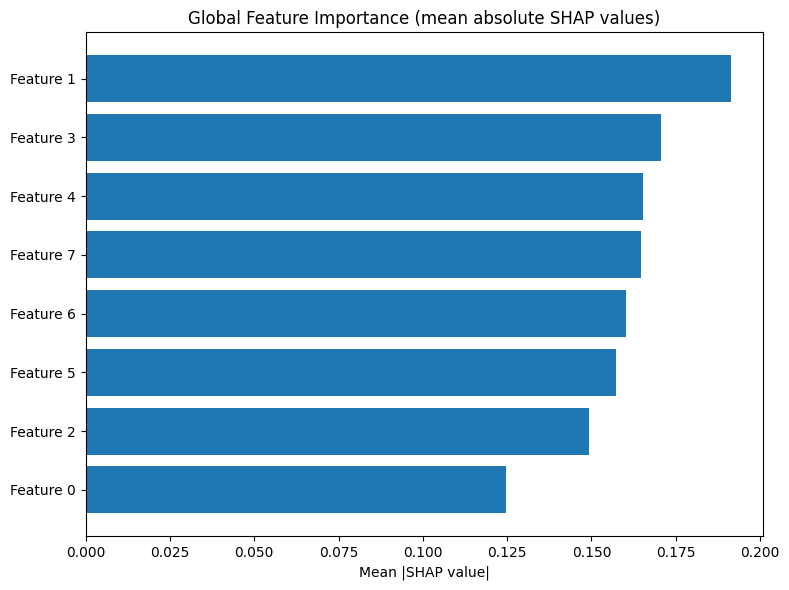

In [ ]:
import shap

num_features_used = shap_values[0].shape[1]

# Create fallback feature names: ['Feature 0', 'Feature 1', ..., 'Feature 7']
feature_names = [f'Feature {i}' for i in range(num_features_used)]

# Stack SHAP values across classes
all_shap_vals = np.vstack(shap_values)  # (num_classes * num_samples, num_features)

# Compute mean absolute SHAP values
mean_abs_shap_vals = np.mean(np.abs(all_shap_vals), axis=0)

# Create DataFrame
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Mean |SHAP value|': mean_abs_shap_vals
}).sort_values(by='Mean |SHAP value|', ascending=True)

# Plot
plt.figure(figsize=(8, 6))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Mean |SHAP value|'])
plt.xlabel('Mean |SHAP value|')
plt.title('Global Feature Importance (mean absolute SHAP values)')
plt.tight_layout()
plt.show()
